# Taller 1

Integrantes: Juliana Bermúdez Guzmán, Sofía Duarte Sanabria.

## Librerías

In [20]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
import itertools


## Calibración de la cámara

Antes de empezar con las imágenes del objeto que queremos construir en 3D, calibramos la cámara utilizando el tablero de ajedrez. El código de esta calibración es tomado de la tarea de clase.

## Preprocesamiento de imágenes

Vamos a utilizar la librería `glob` para extraer las imágenes de la carpeta imágenes.

In [21]:
image_files = glob.glob('../imagenes/*.jpg')
# Ordenar por número en el nombre de la imagen
image_files.sort(key=lambda x: int(x.split('\\')[-1].split(".")[0]))

Utilizamos la función `imread()` para leer las imágenes ya que tenemos sus ubicaciones guardadas en la variable `image_files`. Convertimos las imágenes a escala de grises para optimizar el procesamiento.

In [22]:
# leer imágenes en blanco y negro
images_gray = [cv2.imread(img, cv2.IMREAD_GRAYSCALE) for img in image_files]

Verificamos que todas las imágenes tengan la misma dimensión. A través del bucle que definimos a continuación, comparamos las dimensiones de todas las imágenes y vemos que como no sale el mensaje de alerta, tienen la misma dimensión. Ya esperábamos que pasar esto dado que utilizamos la misma cámara, pero dado que es un paso importante del preprocesamiento cuando se tienen diversas fuentes, preferimos verificarlo.

In [23]:
for i in range(len(images_gray)):
    if i+1 == len(images_gray):
        break
    if images_gray[i].shape != images_gray[i+1].shape:
        print('Las imagenes NO tienen el mismo tamaño')
    

Decidimos utilizar la función `equalizeHist()` para mejorar el contraste redistribuyendo los níveles de intensidad de la imágen.

In [24]:
images_equalized = [cv2.equalizeHist(img) for img in images_gray]

Ahora, utilizamos la función `fastN1MeansDenoising()` [1] para eliminar el ruido sin perder tantos detalles. Elegimos este método, dado que la mayoría de filtros solo toman a los vecinos, mientras que este busca en diferentes regiones dentro de la imagen al tiempo. Otro punto a favor de este método es su capacidad de mantener texturas y bordes intactos, dado que el método gaussiano suaviza bordes y el bilateral puede llegar a hacer uqe pequeños detalles se vean borrosos. Finalmente, este método está optimizado para imágenes en escala de grises, entonces nos sirve dado que estamos trabjando en esa escala [2].

Los hiperparámetros represenan lo siguiente:
* h: potencia del filtro.
* templateWindowSize: tamaño de la región que se va a comparar.
* searchWindowSize: la ventana más grande sobre la que se van a buscar las regiones.

In [25]:
images_denoised = [cv2.fastNlMeansDenoising(img, None, h=10, templateWindowSize=7, searchWindowSize=21)
                    for img in images_equalized]

In [26]:
# cv2.imshow("Prueba", images_gray[0])
# cv2.waitKey(0)
# cv2.destroyAllWindows()

Al analizar las imágenes podemos ver que hay algunas donde los bordes son más marcados y el fondo borroso.

## Detección de Características y Emparejamiento

Vamos a aplicar ORB, entonces tenemos que inicializar el detector. 

In [27]:
orb = cv2.ORB_create()
#Reescalamos para ver mejor
# scale_factor = 2
# images_resized = [cv2.resize(img, None, fx=scale_factor, fy=scale_factor, interpolation=cv2.INTER_CUBIC) for img in images_denoised]

Ahora, lo aplicamos sobre las imágenes a las que les quitamos el ruido.

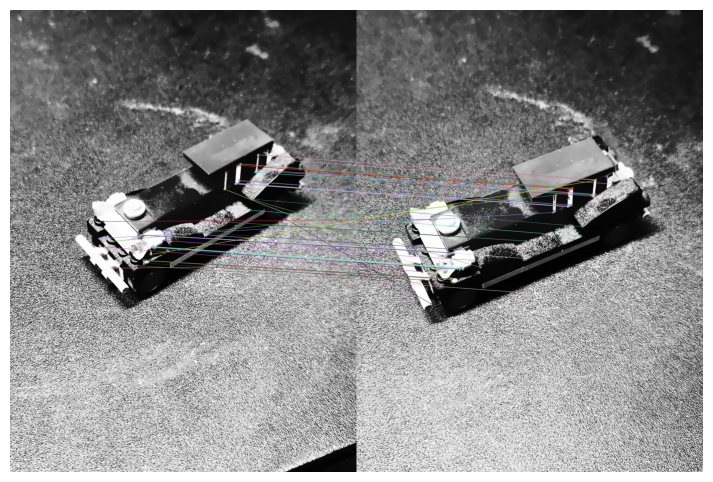

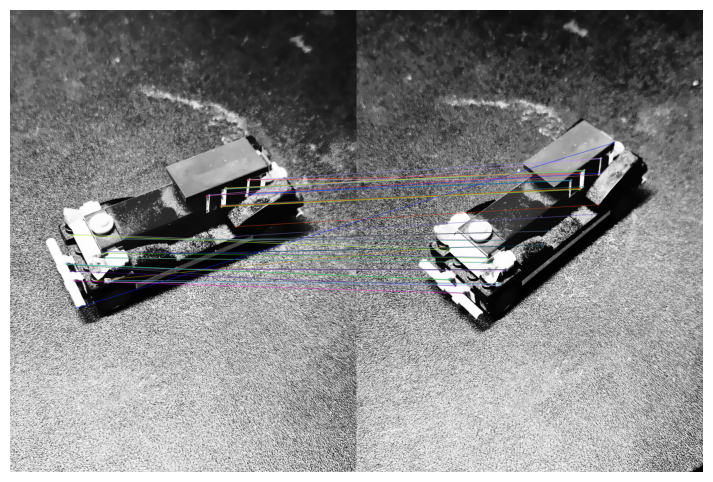

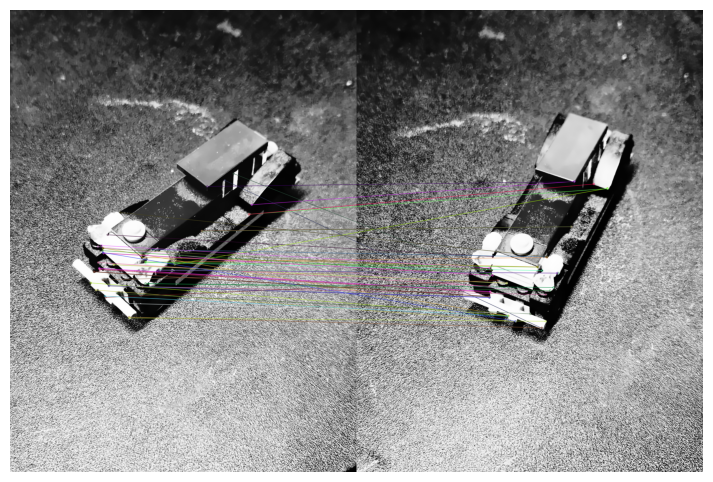

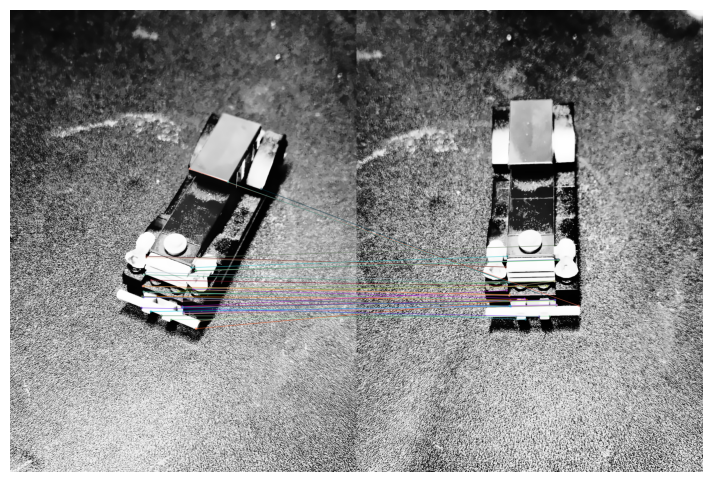

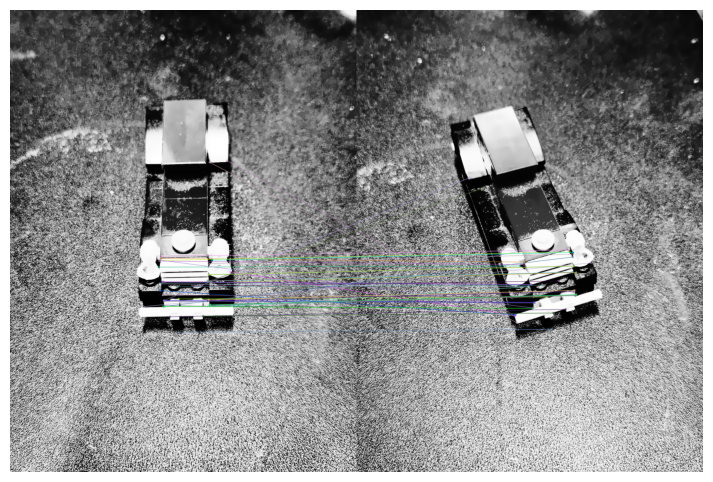

...

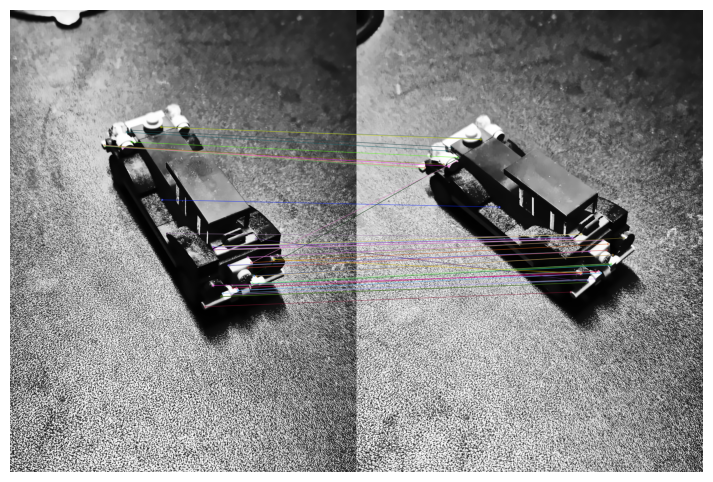

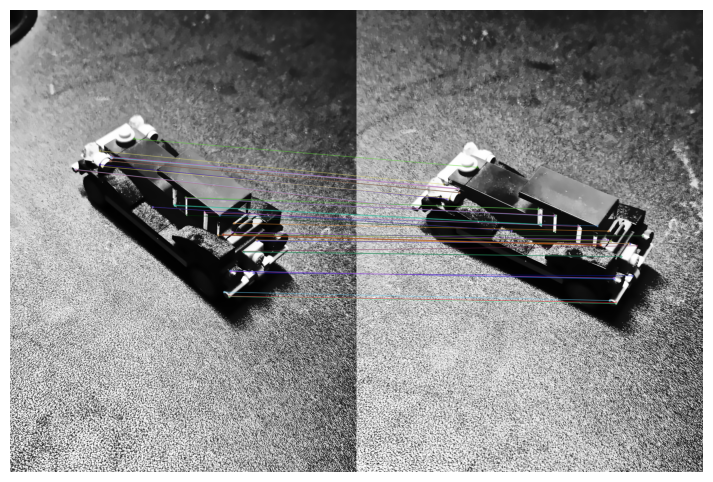

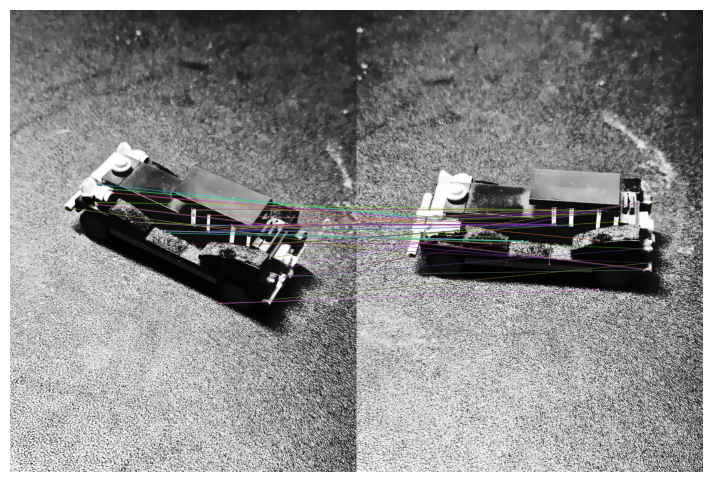

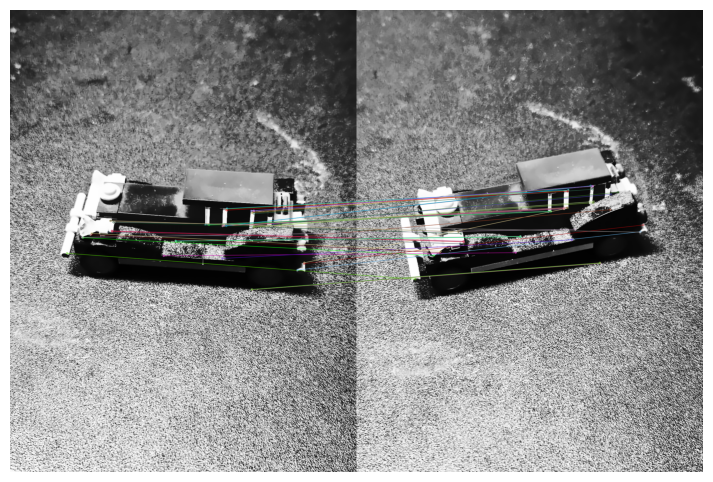

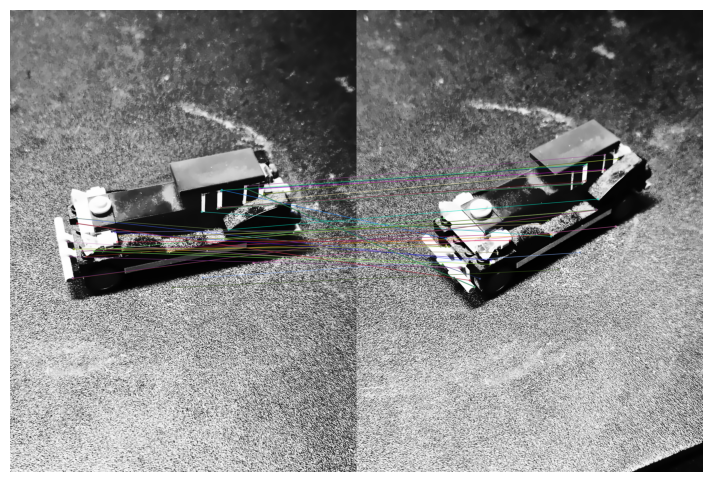

In [32]:
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
keypoints = []
descriptors = []
matchess = []

for i in range(-1, len(images_denoised)-1):
    keypoints1, descriptors1 = orb.detectAndCompute(images_denoised[i], None)
    keypoints2, descriptors2 = orb.detectAndCompute(images_denoised[i+1], None)
    matches = bf.match(descriptors1, descriptors2)
    matches = sorted(matches, key=lambda x: x.distance)
    keypoints.append((keypoints1, keypoints2))
    descriptors.append((descriptors1, descriptors2))
    matchess.append(matches)

    # Gráficas
    img_matches = cv2.drawMatches(images_denoised[i], keypoints1, images_denoised[i+1], keypoints2, matches[:50], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    # Show the image
    plt.figure(figsize=(12, 6))
    plt.imshow(img_matches)
    plt.axis('off')
    plt.show()

## Estimación de la Matriz Fundamental y la Matriz Esencial

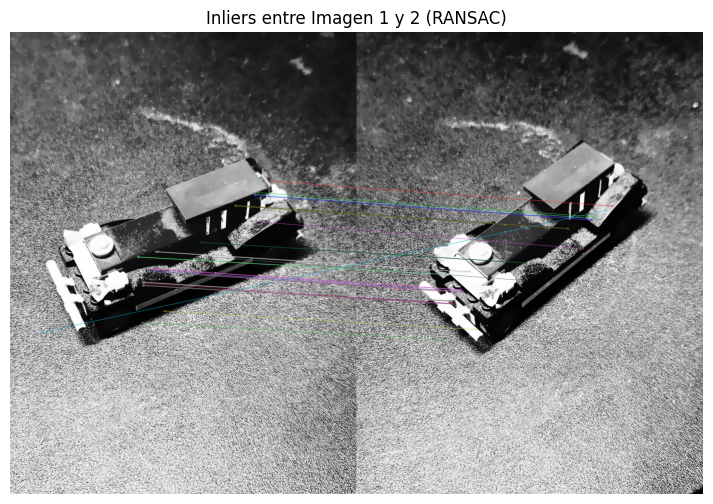

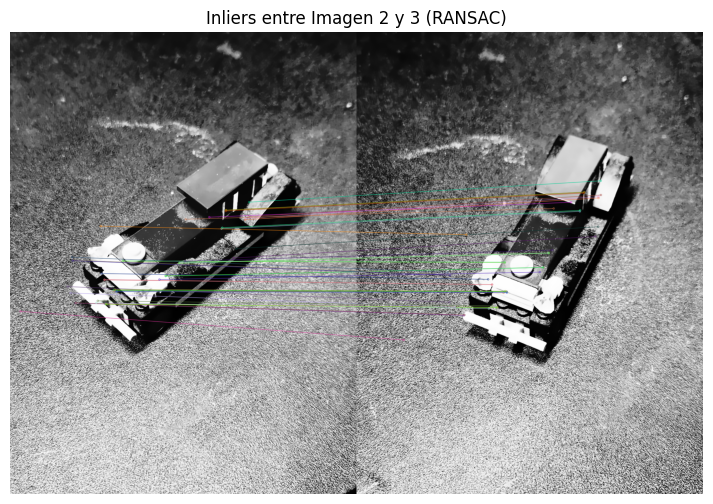

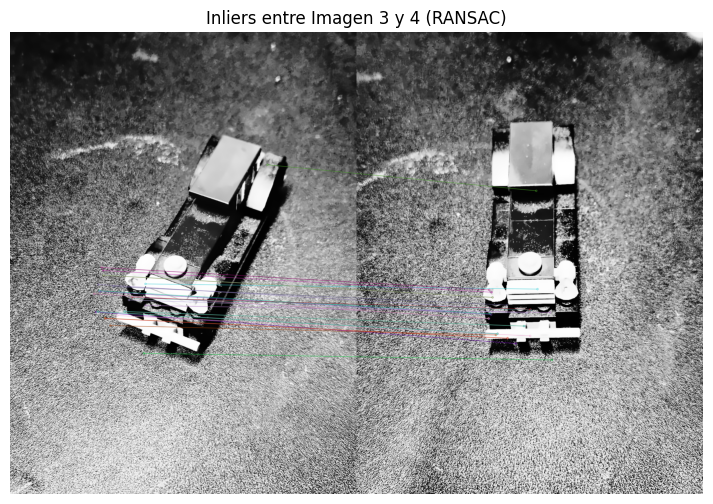

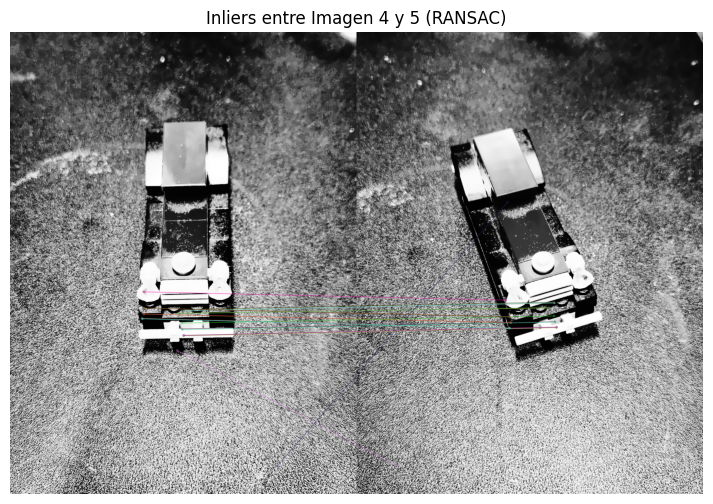

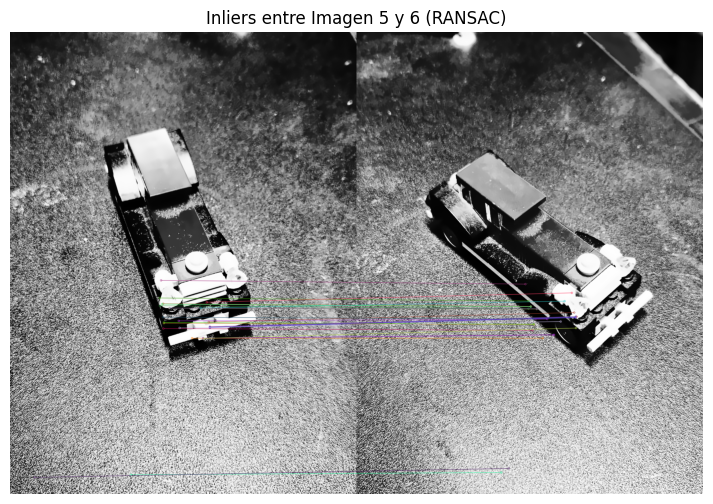

...

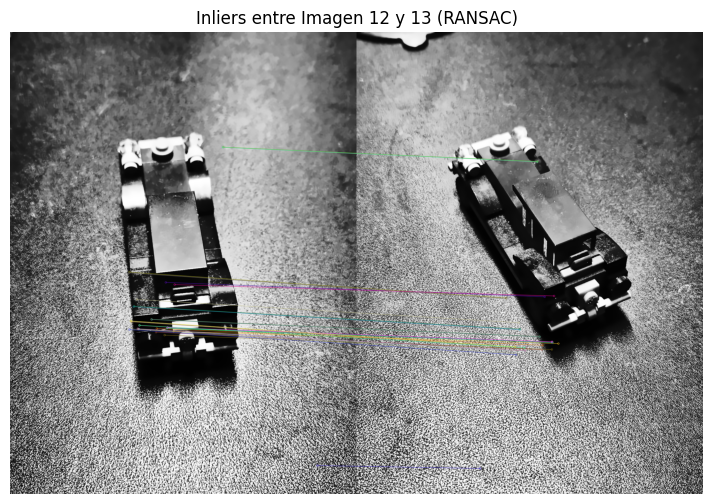

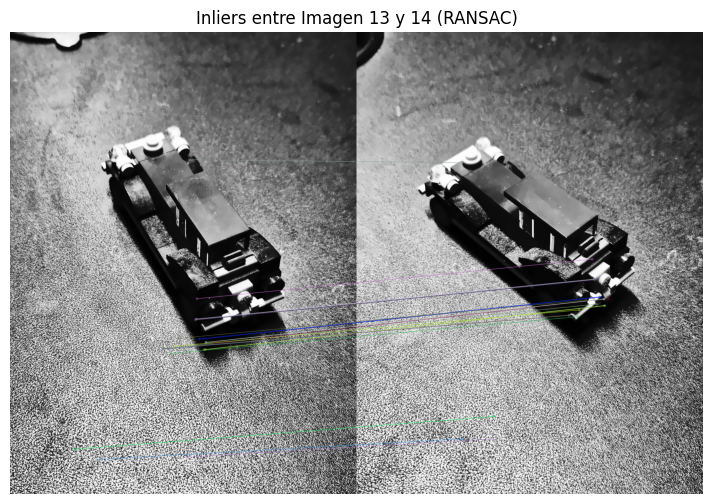

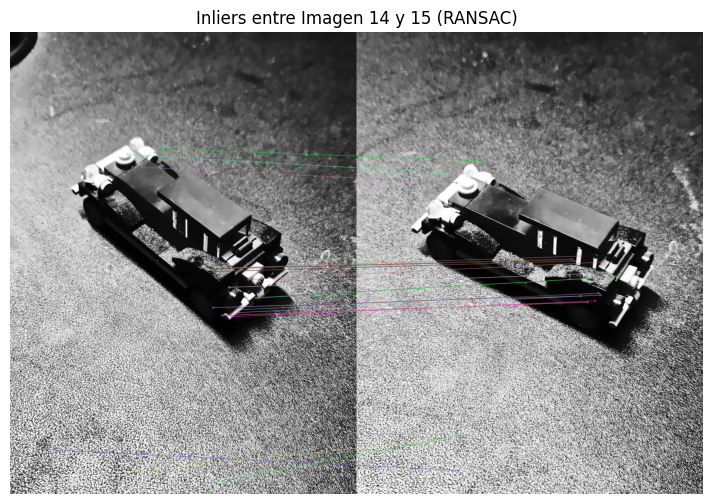

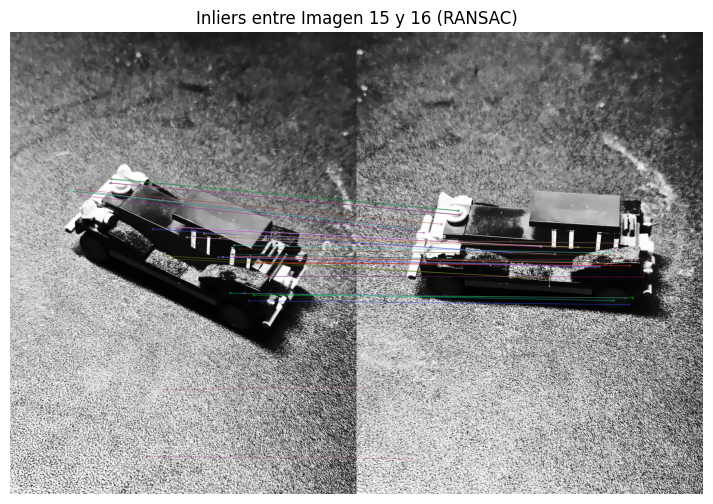

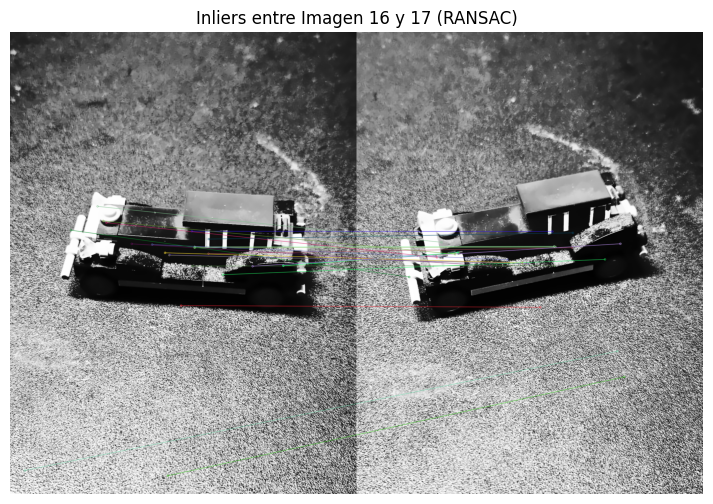

Matriz Fundamental entre Imagen 1 e Imagen 2:
 [[ 2.14550448e-09 -5.75376010e-06  2.11256904e-03]
 [ 7.46390070e-06 -4.25447152e-07 -8.36055905e-03]
 [-3.23865388e-03  7.33314384e-03  1.00000000e+00]]
Matriz Fundamental entre Imagen 2 e Imagen 3:
 [[ 2.45097247e-06 -1.55251494e-05  3.91549899e-03]
 [ 8.30160554e-06 -1.22120379e-06 -4.29040514e-02]
 [-1.03481334e-02  4.95156120e-02  1.00000000e+00]]
Matriz Fundamental entre Imagen 3 e Imagen 4:
 [[ 2.42397238e-06 -6.81061842e-06  5.27218972e-03]
 [ 5.46613149e-06  2.47764908e-06 -2.67851675e-03]
 [-6.00270338e-03 -3.43834026e-04  1.00000000e+00]]
Matriz Fundamental entre Imagen 4 e Imagen 5:
 [[ 1.75968798e-06 -4.33221251e-06  3.29162264e-03]
 [ 4.52133889e-06  4.74458907e-07 -3.73388114e-03]
 [-5.83705883e-03  3.02436861e-03  1.00000000e+00]]
Matriz Fundamental entre Imagen 5 e Imagen 6:
 [[ 8.82093723e-08  5.51605640e-07 -4.91481601e-03]
 [ 1.15869771e-07 -1.91691410e-06 -1.12508179e-02]
 [ 3.81013998e-04  1.46287674e-02  1.00000000e+

In [ ]:
fundamental_matrices = []
pts = []

for i in range(-1, len(matchess)-2):
    keypoints1, keypoints2 = keypoints[i]
    matches = matchess[i]

    # Extraer coordenadas de los puntos emparejados
    pts1 = np.float32([keypoints1[m.queryIdx].pt for m in matches])
    pts2 = np.float32([keypoints2[m.trainIdx].pt for m in matches])
    
    pts.append((pts1, pts2))

    # Calcular la matriz fundamental con RANSAC
    F, mask = cv2.findFundamentalMat(pts1, pts2, cv2.FM_RANSAC, ransacReprojThreshold=1.0, confidence=0.99)
    fundamental_matrices.append(F)

    # Filtrar solo los inliers
    inlier_matches = [matches[i] for i in range(len(matches)) if mask[i]]

    # Dibujar solo los inliers
    img_inliers = cv2.drawMatches(images_denoised[i], keypoints1, images_denoised[i+1], keypoints2, inlier_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    # Mostrar imagen con inliers
    plt.figure(figsize=(12, 6))
    plt.imshow(img_inliers)
    plt.title(f"Inliers entre Imagen {i+1} y {i+2} (RANSAC)")
    plt.axis("off")
    plt.show()

# Ver las matrices fundamentales obtenidas
for idx, F in enumerate(fundamental_matrices):
    print(f"Matriz Fundamental entre Imagen {idx+1} e Imagen {idx+2}:\n", F)

### Esencial

Después :)

In [ ]:
essential_matrices = []
K = np.array([[fx, 0, cx],  # Replace with your actual intrinsics
              [0, fy, cy],
              [0,  0,  1]])

for F in fundamental_matrices:
    E = K.T @ F @ K  # Convert F to E
    essential_matrices.append(E)

# Print essential matrices
for idx, E in enumerate(essential_matrices):
    print(f"Essential Matrix between Image {idx+1} and {idx+2}:\n", E)

### Rotación y traslación

In [ ]:
R_matrices = []
t_vectors = []
pts_copy = pts.copy()
for E in essential_matrices:
    pts1, pts2 = pts_copy.pop(0)
    _, R, t, _ = cv2.recoverPose(E, pts1, pts2, K)
    R_matrices.append(R)
    t_vectors.append(t)

for i, (R, t) in enumerate(zip(R_matrices, t_vectors)):
    print(f"Rotation Matrix for Image {i+1} -> {i+2}:\n", R)
    print(f"Translation Vector for Image {i+1} -> {i+2}:\n", t)

### Triangulación

In [ ]:
projection_matrices = []
projection_matrices.append(K @ np.hstack((np.eye(3), np.zeros((3, 1)))))  # First camera at origin

for i in range(len(R_matrices)):  # Assuming R_matrices and t_vectors are in order
    P = K @ np.hstack((R_matrices[i], t_vectors[i]))
    projection_matrices.append(P)

print("Total projection matrices:", len(projection_matrices))


## Reconstrucción 3D con PyCOLMAP

## Referencias

[1] “Denoising,” OpenCV, https://docs.opencv.org/3.4/d1/d79/group__photo__denoise.html#ga76abf348c234cecd0faf3c42ef3dc715 (accessed Feb. 19, 2025). 

[2] GeeksforGeeks, “Image enhancement techniques using opencv - python,” GeeksforGeeks, https://www.geeksforgeeks.org/image-enhancement-techniques-using-opencv-python/ (accessed Feb. 19, 2025). 